# Fuzzy Control

## 1.  Set Partitioning

### Current Percentage

We aim to maintain current percentage value at 60%, so I considered 0.6 as my reference,
“aroundref.” I regarded 0.6+ values as "above" and it meant “It is too much! Decrease this
value !”. Similarly, I called “below” for 0.6- values, and it indicated “Increase this value !”.
Since “below” and “above” had explicit meaning, I did not overlap these two sets. However,
“aroundref” included values from both sets because, for example, 0.61 could refer to “above”
and “aroundref”, close to the reference value.

### Control Variable

To partition this set, I complied the logic of semantic, similar to “current percentage” case: If
I would like to increase the infection rate, I should add positive value, which refers to 0-0.15
in the set, I called “up”. I called “down” for -0.15-0 in the set that meant I would like to
decrease the infection rate. Around zero value expressed that I would like to maintain
infection rate value so I called “donothing”.

### Membership Function for the Sets

I tried many membership functions to find the best model (Note: My metric for “the best” is
the “cost”). I compared four different membership
functions for input and output. So I had 16 cases to test (See Table-1).
The corresponding codes are given below:

In [1]:
import skfuzzy as fuzz
from skfuzzy import control as ctrl
import numpy as np
import os
from matplotlib import pyplot as plt
from matplotlib import ticker
import math
"""
Set Partitioning
We will create 4 different membership functions for
measurement and outputs.
So, We will compare 16 different simulation results.
"""
# Parition sets for the measurement
e1=ctrl.Antecedent(np.arange(0,1,0.001), 'per1')
e1['above']=fuzz.trapmf(e1.universe, [0.6,1,1,1])
e1['aroundref']=fuzz.trapmf(e1.universe,[0.58,0.59,0.61,0.62])
e1['below']=fuzz.trapmf(e1.universe, [0,0,0.2,0.6])

e2=ctrl.Antecedent(np.arange(0,1,0.001), 'per2')
e2['above']=fuzz.sigmf(e2.universe, 0.8,30)
e2['aroundref']=fuzz.pimf(e2.universe, 0.59,0.59,0.61,0.61)
e2['below']=fuzz.sigmf(e2.universe[::-1], 0.6,30)

e3=ctrl.Antecedent(np.arange(0,1,0.001), 'per3')
e3['above']=fuzz.trapmf(e3.universe, [0.6,1,1,1])
e3['aroundref']=fuzz.trimf(e3.universe, [0.59,0.6,0.61])
e3['below']=fuzz.trapmf(e3.universe, [0,0,0,0.6])

e4=ctrl.Antecedent(np.arange(0,1,0.001), 'per4')
e4['above']=fuzz.smf(e4.universe, 0.6,1)
e4['aroundref']=fuzz.gbellmf(e4.universe, 0.002,1,0.6)
e4['below']=fuzz.smf(e4.universe[::-1], 0.4,1)

# Partition sets for the output
u1=ctrl.Consequent(np.arange(-0.15,0.15,0.001), 'control1')
u1['up'] = fuzz.smf(u1.universe, 0, 0.15)
u1['donothing']=fuzz.gbellmf(u1.universe,0.002, 5 ,0)
u1['down'] = fuzz.smf(-u1.universe, 0 , 0.15)

u2=ctrl.Consequent(np.arange(-0.15,0.15,0.001), 'control2')
u2['up'] = fuzz.trapmf(u2.universe, [0,0.15,0.15,0.15] )
u2['donothing']=fuzz.trimf(u2.universe,[-0.004,0,0.004])
u2['down'] = fuzz.trapmf(u2.universe,[-0.15,-0.15,-0.15,0])

u3=ctrl.Consequent(np.arange(-0.15,0.15,0.001), 'control3')
u3['up'] = fuzz.smf(u3.universe, -0.01, 0.15)
u3['donothing']=fuzz.gbellmf(u3.universe,0.005, 5 ,0)
u3['down'] = fuzz.smf(-u3.universe, -0.01 , 0.15)

u4=ctrl.Consequent(np.arange(-0.15,0.15,0.001), 'control4')
u4['up'] = fuzz.trapmf(u4.universe, [-0.01,0.15,0.15,0.15] )
u4['donothing']=fuzz.trimf(u4.universe,[-0.008,0,0.008])
u4['down'] = fuzz.trapmf(u4.universe,[-0.15,-0.15,-0.15,0.01])

/home/cagnur/anaconda3/envs/dl/lib/python3.9/site-packages/skfuzzy/membership/generatemf.py:231: RuntimeWarning: invalid value encountered in true_divide
  y[idx] = 2. * ((x[idx] - a) / (b - a)) ** 2.
/home/cagnur/anaconda3/envs/dl/lib/python3.9/site-packages/skfuzzy/membership/generatemf.py:240: RuntimeWarning: invalid value encountered in true_divide
  y[idx] = 2. * ((x[idx] - d) / (d - c)) ** 2.


Their characteristics could be list as folows:
* Per1 and per2 have more symmetric around the reference value than per3 and per4.
    * Per1 and per2 have similar behavior, per3 and per4 have variant attitudes
around the reference value.
* Per1 and per3 have sharp edges. On the other hand, Per2 and per4 have smooth transitions.
* All output membership has symmetry around the zero.
* Control1 and control3 have smooth transitions. On the other hand, control2 and Control4 have sharp edges.
* Control1 and control2 do not mix “up” and “down” sets. On the other hands, Control3 and Control4 overlap these sets.

## 2. Rules

The rules relied on very basic logic:
* If the current percentage is below the reference value, the infection rate should be increased
* If the current percentage is around the reference value, the infection rate should be maintain, so we should not try to change infection rate (because we ignored disappearance rate in this part.)
* If the current percentage is above the reference value, the infection rate should be decreased.

Because I decided that I would continue for Plague_V2 part with the best performance and I
had 16 different models, I wrote 16 different rules based on rules defined above. The
corresponding codes are given below:

In [2]:
# Define rules:
# ref value=0.6 (=60%)

# if the percentage is above the ref value, then make it less severe
rule_11a=ctrl.Rule(e1['above'], u1['down'])
# if the percentage is around the ref value, then do nothing (we ignore disapperance value in this case)
rule_11b=ctrl.Rule(e1['aroundref'], u1['donothing'])
# if the percentage is below the ref value, then make it more severe
rule_11c=ctrl.Rule(e1['below'], u1['up'])
# Create control system:
viruse_ctrl_11=ctrl.ControlSystem([rule_11a, rule_11b, rule_11c])

rule_12a=ctrl.Rule(e1['above'], u2['down'])
rule_12b=ctrl.Rule(e1['aroundref'], u2['donothing'])
rule_12c=ctrl.Rule(e1['below'], u2['up'])
viruse_ctrl_12=ctrl.ControlSystem([rule_12a, rule_12b,rule_12c])

rule_13a=ctrl.Rule(e1['above'], u3['down'])
rule_13b=ctrl.Rule(e1['aroundref'], u3['donothing'])
rule_13c=ctrl.Rule(e1['below'], u3['up'])
viruse_ctrl_13=ctrl.ControlSystem([rule_13a, rule_13b,rule_13c])

rule_14a=ctrl.Rule(e1['above'], u4['down'])
rule_14b=ctrl.Rule(e1['aroundref'], u4['donothing'])
rule_14c=ctrl.Rule(e1['below'], u4['up'])
viruse_ctrl_14=ctrl.ControlSystem([rule_14a, rule_14b,rule_14c])

rule_21a=ctrl.Rule(e2['above'], u1['down'])
rule_21b=ctrl.Rule(e2['aroundref'], u1['donothing'])
rule_21c=ctrl.Rule(e2['below'], u1['up'])
viruse_ctrl_21=ctrl.ControlSystem([rule_21a,rule_21c])

rule_22a=ctrl.Rule(e2['above'], u2['down'])
rule_22b=ctrl.Rule(e2['aroundref'], u2['donothing'])
rule_22c=ctrl.Rule(e2['below'], u2['up'])
viruse_ctrl_22=ctrl.ControlSystem([rule_22a, rule_22b,rule_22c])
rule_23a=ctrl.Rule(e2['above'], u3['down'])
rule_23b=ctrl.Rule(e2['aroundref'], u3['donothing'])
rule_23c=ctrl.Rule(e2['below'], u3['up'])
viruse_ctrl_23=ctrl.ControlSystem([rule_23a, rule_23b,rule_23c])
rule_24a=ctrl.Rule(e2['above'], u4['down'])
rule_24b=ctrl.Rule(e2['aroundref'], u4['donothing'])
rule_24c=ctrl.Rule(e2['below'], u4['up'])
viruse_ctrl_24=ctrl.ControlSystem([rule_24a, rule_24b,rule_24c])
rule_31a=ctrl.Rule(e3['above'], u1['down'])
rule_31b=ctrl.Rule(e3['aroundref'], u1['donothing'])
rule_31c=ctrl.Rule(e3['below'], u1['up'])
viruse_ctrl_31=ctrl.ControlSystem([rule_31a, rule_31b,rule_31c])
rule_32a=ctrl.Rule(e3['above'], u2['down'])
rule_32b=ctrl.Rule(e3['aroundref'], u2['donothing'])
rule_32c=ctrl.Rule(e3['below'], u2['up'])
viruse_ctrl_32=ctrl.ControlSystem([rule_32a, rule_32b,rule_32c])
rule_33a=ctrl.Rule(e3['above'], u3['down'])
rule_33b=ctrl.Rule(e3['aroundref'], u3['donothing'])
rule_33c=ctrl.Rule(e3['below'], u3['up'])
viruse_ctrl_33=ctrl.ControlSystem([rule_33a, rule_33b,rule_33c])
rule_34a=ctrl.Rule(e3['above'], u4['down'])
rule_34b=ctrl.Rule(e3['aroundref'], u4['donothing'])
rule_34c=ctrl.Rule(e3['below'], u4['up'])
viruse_ctrl_34=ctrl.ControlSystem([rule_34a, rule_34b,rule_34c])
rule_41a=ctrl.Rule(e4['above'], u1['down'])
rule_41b=ctrl.Rule(e4['aroundref'], u1['donothing'])
rule_41c=ctrl.Rule(e4['below'], u1['up'])
viruse_ctrl_41=ctrl.ControlSystem([rule_41a, rule_41b,rule_41c])
rule_42a=ctrl.Rule(e4['above'], u2['down'])
rule_42b=ctrl.Rule(e4['aroundref'], u2['donothing'])
rule_42c=ctrl.Rule(e4['below'], u2['up'])
viruse_ctrl_42=ctrl.ControlSystem([rule_42a, rule_42b,rule_42c])
rule_43a=ctrl.Rule(e4['above'], u3['down'])
rule_43b=ctrl.Rule(e4['aroundref'], u3['donothing'])
rule_43c=ctrl.Rule(e4['below'], u3['up'])
viruse_ctrl_43=ctrl.ControlSystem([rule_43a, rule_43b,rule_43c])
rule_44a=ctrl.Rule(e4['above'], u4['down'])
rule_44b=ctrl.Rule(e4['aroundref'], u4['donothing'])
rule_44c=ctrl.Rule(e4['below'], u4['up'])
viruse_ctrl_44=ctrl.ControlSystem([rule_44a, rule_44b,rule_44c])

## 3. Fuzzification and Defuzzification Interface & Simulation

If you notice, the codes given above consist of “ctrl.ControlSystem(...)”. This code defines one
of the class instances of the ControlSystem class, which contains a fuzzy control system, in
Scikit Fuzzy library. The source code for the ControlSystem class is defined here. To simulate
this control system, I used another class in this library: ControlSystemSimulation. (The source
code of this class could be found in the same hyperlink). According to the Mamdani interface,
the “compute” method of this class computes outputs of the control system (See lecture notes
for Mamdani).
Instead of giving 16 different simulations’ code, I just give one of them. All has same process
as given below:

I wrote helper function to find steady state: find_ss(.):

In [3]:
def find_ss(b):
    """"
    Find when the viruse spread reaches the steady state:
    Assume steady state is reached if the number 0.6 comes 10
    times in a row !!!!!
    Input type : list
    """
    # round the float value to 3 decimals
    a=[]
    for i in range(len(b)):
        a.append(float("{0:.2f}".format(b[i])))
    # Create an array that is 1 where a is 0.600=0.6  (reference value), and pad each end with an extra 0.
    isref = np.concatenate(([0], np.equal(a,0.6).view(np.int8), [0]))
    absdiff = np.abs(np.diff(isref))
    # Runs start and end where absdiff is 1.
    ranges = np.where(absdiff == 1)[0].reshape(-1, 2)
    ss_day=0 # ss_day may not be created in the for loop so  define in here
    for j in range(len(ranges)):
        # check whether "0.600" occurs at least 10 times
        if (ranges[j][1]-ranges[j][0])>=10:
            ss_day=ranges[j][0]
            #print("Number of days passed until the equilibrium = "+str(ss_day))
            #print("Cost = "+str(sum(b[:ss_day])))
            break # found, done !
    return ss_day

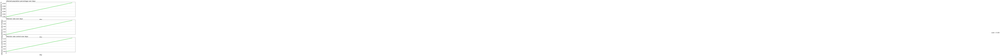

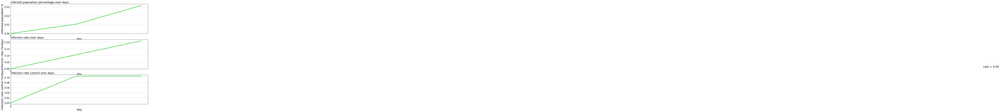

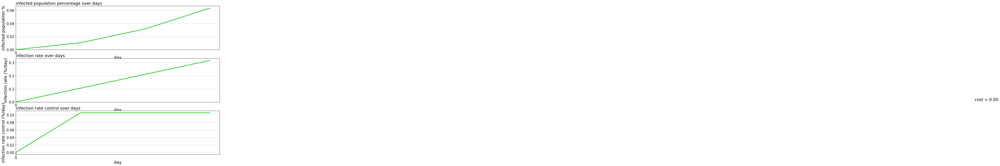

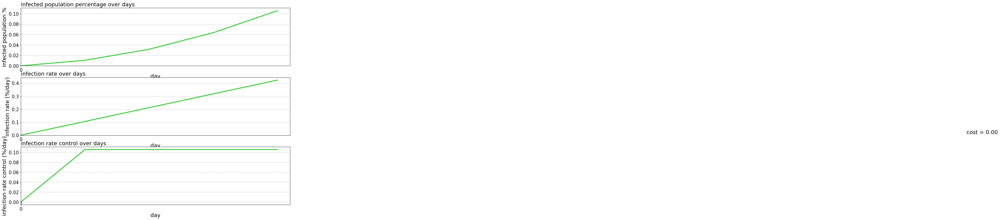

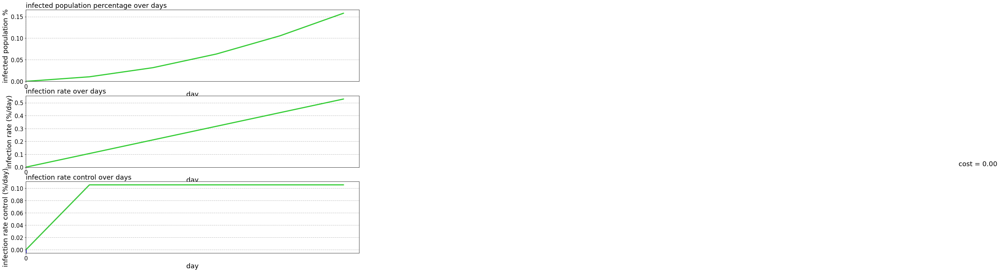

...

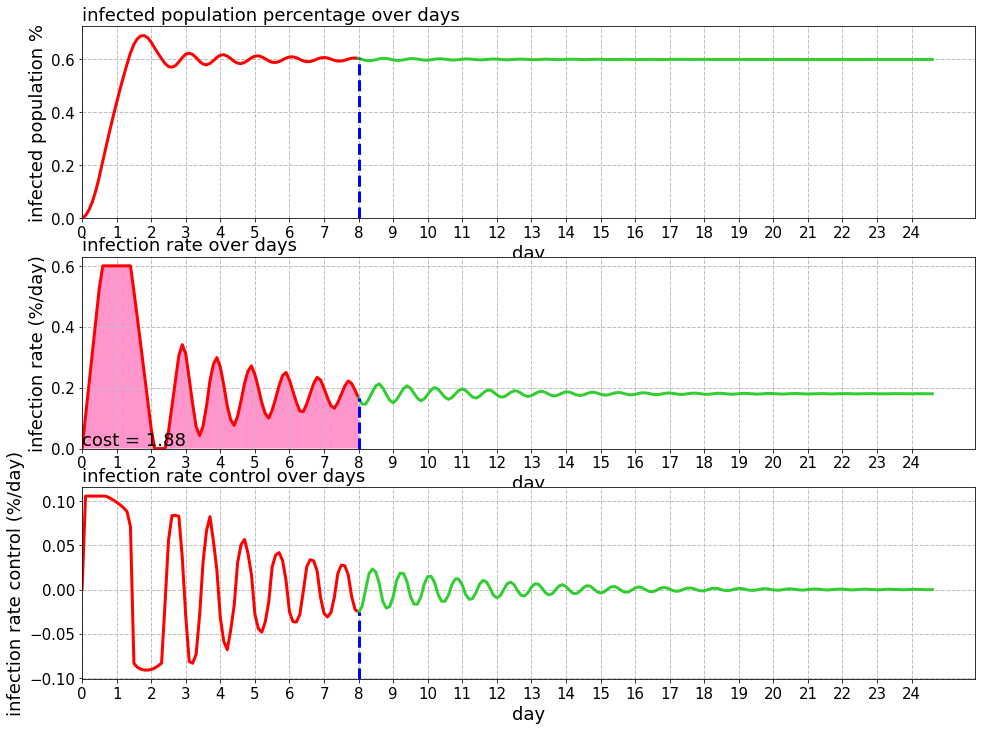

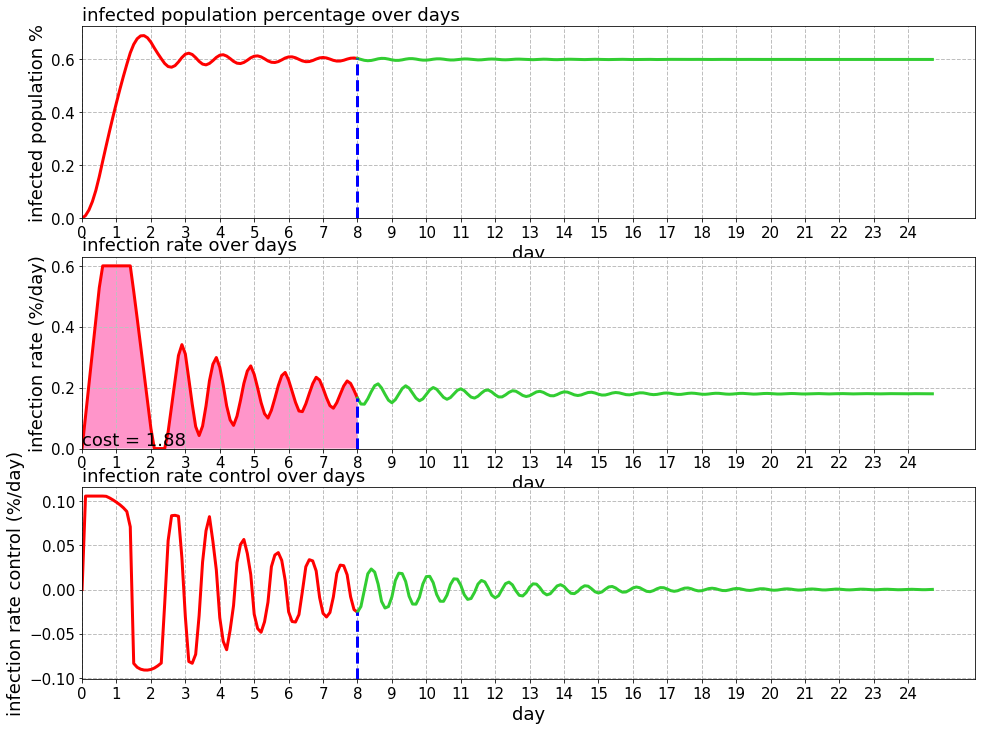

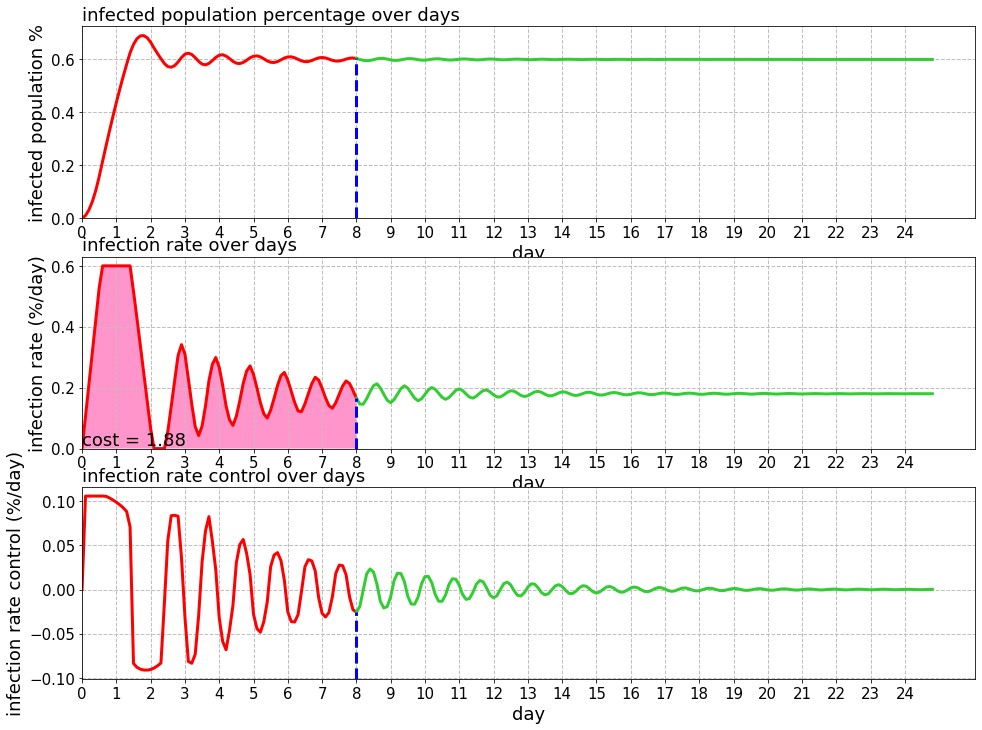

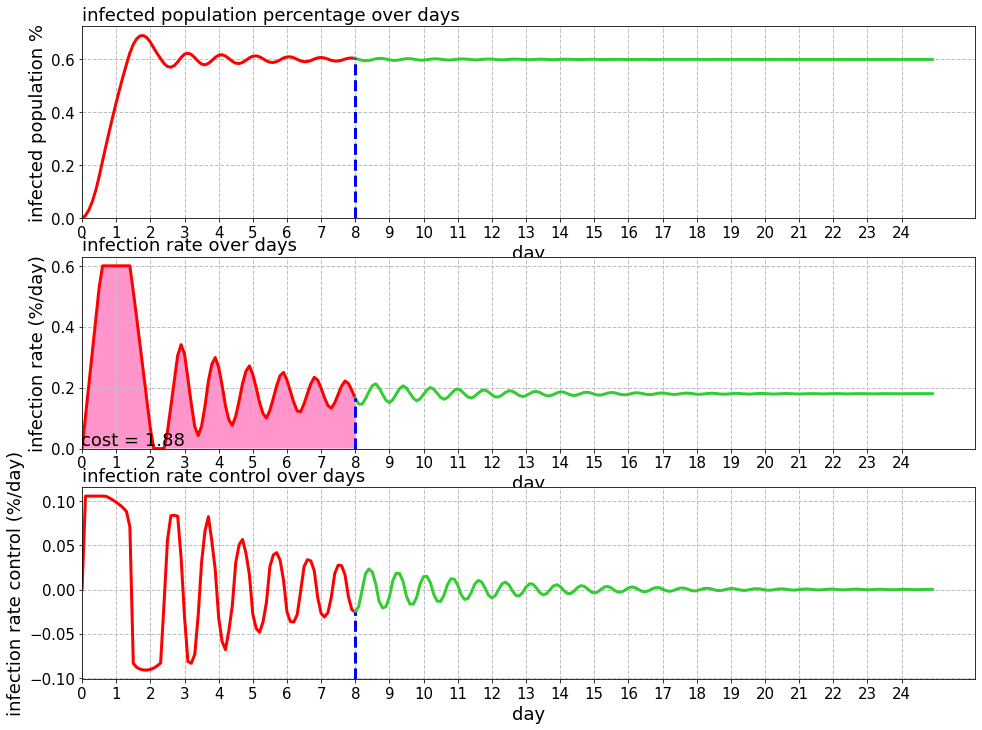

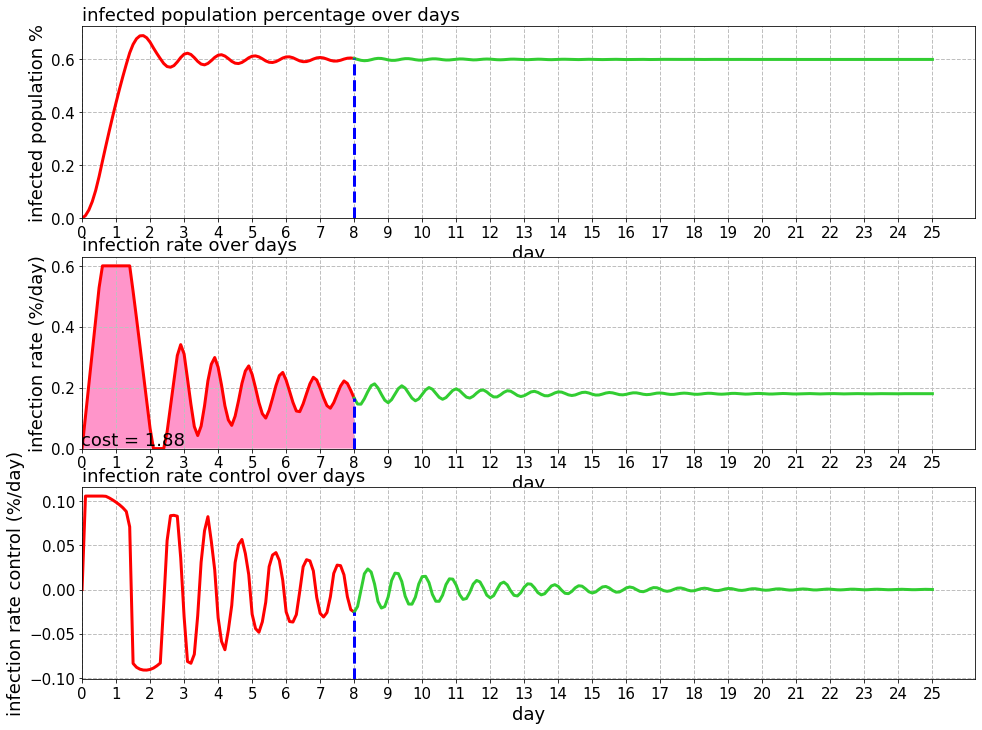

In [4]:
"""Simulate and Compare """
from plague import Plague
# Create plague instance
kill_bots_11=Plague()
# Simulate the control system:
viruse_sim_11=ctrl.ControlSystemSimulation(viruse_ctrl_11)
# 0.1 day (=2.4 hours) for each change so for one day 10 update is required
step=250
per=0 # Initial percentage
for day in range(step):
    viruse_sim_11.input['per1'] = per
    # The fuzzification and defuzzification is handled in "compute" method according to Mamdani interface
    viruse_sim_11.compute()
    x=viruse_sim_11.output['control1']
    # update values, call method
    kill_bots_11.spreadPlague(x)
    # learn the new percentage, per
    (per,effective_infection_rate)=kill_bots_11.checkInfectionStatus()
    # find the equilibrium point / steady state
    ss_Day_11=find_ss(kill_bots_11.infected_percentage_curve_)
    # find the cost (per day*10)
    c_11=sum(kill_bots_11.infection_rate_curve_[:ss_Day_11])
    # find cost (per day)
    c_11=c_11/10
    # view the results
    kill_bots_11.viewPlague(point_ss=ss_Day_11, plague_cost=c_11,
    save_dir='./', filename='part_1', show_plot=True)

It assumes that if the current percentage is maintained at 0.6 value ten times in a row, it
returns the index of the first value of the row. In other words, if the rounded-value of the list
returns 0.6 at least ten times consecutively, it assumes that the current infected percentage
could be maintained successfully. Then, it returns the first index of the row. Since each step/change corresponds to 0.1 day (=2.4 hours), ten updates are required for one day. So,
we divide by ten to use viewPlague(.) function.  

The overall results are given in Table-1. According to these results, I continued with per3
and control3 whose output has the lowest cost as summarized in Table-2.